In [36]:
from sympy import symbols, lambdify, sin, cos, tanh, exp, log, Max
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import _cntr as cntr
import os
from mpl_toolkits.mplot3d import Axes3D


import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.animation as animation
from JSAnimation import IPython_display

class warp_demo:
    
    def __init__(self):
        a = 0
        self.orig_data = []
        self.transformed_data = []
        self.original_separator = []
        self.transformed_separator = []
        self.labels = []
        self.ind0 = []
        self.ind1 = []
        self.grid = []
        
    # define the user-defined transformation in numpy
    def define_rule(self,rule1,rule2):
        x1,x2 = symbols('x1 x2')
        self.rule1 = lambdify((x1,x2),rule1,np)
        self.rule2 = lambdify((x1,x2),rule2,np)

    # transform data bsaed on user-defined transformations
    def make_rule(self,data):
        s = data[:,0]
        t = data[:,1]

        ## transform space - each axes - via net transform    
        f1 = self.rule1(s,t)
        f1.shape = (len(f1),1)

        # transform using basis element 2
        f2 = self.rule2(s,t)
        f2.shape = (len(f2),1)

        return f1,f2
    
    # create points based on user-defined transformations
    def make_pts(self):
        # generate datapoints based on user-defined rule
        r = np.linspace(-10.1,10.1,2000)
        s,t = np.meshgrid(r,r)
        s = np.reshape(s,(np.size(s),1))
        t = np.reshape(t,(np.size(t),1))
        h = np.concatenate((s,t),axis = 1)

        # use rule to partition the input space
        f1,f2 = self.make_rule(h)

        # cut the space to make this rule
        z = f1 + f2
        z = (np.sign(z))
        s.shape = (np.size(r),np.size(r))
        t.shape = (np.size(r),np.size(r))
        z.shape = (np.size(r),np.size(r))
        
        ## build dataset based on this rule
        num_pts = 200   # number of points for dataset
        X = -5 + 10*np.random.rand(num_pts,2)
        g1,g2 = self.make_rule(X)
        pts = g1 + g2

        ind0 = np.argwhere(pts <= 0)
        ind0 = [v[0] for v in ind0]
        ind1 = np.argwhere(pts > 0)
        ind1 = [v[0] for v in ind1]

        y = np.zeros((num_pts,1))
        y[ind0] = -1
        y[ind1] = 1

        # form transformed dataset
        T = np.concatenate((g1,g2),axis = 1)

        # store original and transformed data
        self.orig_data = X
        self.transformed_data = T
        self.labels = y
        self.ind0 = ind0
        self.ind1 = ind1
        
        # now that points are stored, we can make a warpable grid
        self.make_warpable_grid()

    # make the adjustable grid
    def make_warpable_grid(self):
        # define range of grid
        horz_max = max(max(self.orig_data[:,0]),max(self.transformed_data[:,0]))
        horz_min = min(min(self.orig_data[:,0]),min(self.transformed_data[:,0]))
        
        vert_max = max(max(self.transformed_data[:,1]),max(self.transformed_data[:,1]))
        vert_min = min(min(self.orig_data[:,1]),min(self.transformed_data[:,1]))
        
        s = np.linspace(-10,10,40)
        s.shape = (len(s),1)
        g = np.array([-10,-10])
        g.shape = (1,len(g))
        e = np.linspace(-10,10,200)
        e.shape = (len(e),1)
        f = np.ones((200,1))
        f.shape = (len(f),1)
        for a in s:
            t = a*f
            h = np.concatenate((e,t),axis = 1)
            i = np.concatenate((t,e),axis = 1)
            j = np.concatenate((h,i),axis = 0)
            g = np.concatenate((g,j),axis = 0)

        self.grid = g[1:,:]
        
    # plot the before data, separator, and grid
    def show_before_picture(self):
        # make figure
        fig = plt.figure(figsize = (5,5))
        ax1 = fig.add_subplot(111)          # panel for original space
        
        ### plot original data and separator
        r = np.linspace(-5.1,5.1,2000)
        s,t = np.meshgrid(r,r)
        s = np.reshape(s,(np.size(s),1))
        t = np.reshape(t,(np.size(t),1))
        h = np.concatenate((s,t),axis = 1)

        # use rule to partition the input space
        f1,f2 = self.make_rule(h)
        z = f1 + f2
        z = (np.sign(z))
        s.shape = (np.size(r),np.size(r))
        t.shape = (np.size(r),np.size(r))
        z.shape = (np.size(r),np.size(r))
        
        # plot points and separator
        self.plot_pts(self.orig_data,ax1)
        self.plot_separator(s,t,z,ax1)
        ax1.set_xlim([-5.3,5.3])
        ax1.set_ylim([-5.3,5.3])

        # plot grid
        grid1 = self.grid
        self.plot_grid(grid1,ax1)
        ax1.axis('off')
        
    # create the figure 
    def show_before_and_after(self):
        # make figure
        fig = plt.figure(figsize = (10,5))
        ax1 = fig.add_subplot(121)          # panel for original space
        ax2 = fig.add_subplot(122)          # panel transformed space
        
        ### plot original data and separator
        r = np.linspace(-5.1,5.1,2000)
        s,t = np.meshgrid(r,r)
        s = np.reshape(s,(np.size(s),1))
        t = np.reshape(t,(np.size(t),1))
        h = np.concatenate((s,t),axis = 1)

        # use rule to partition the input space
        f1,f2 = self.make_rule(h)
        z = f1 + f2
        z = (np.sign(z))
        s.shape = (np.size(r),np.size(r))
        t.shape = (np.size(r),np.size(r))
        z.shape = (np.size(r),np.size(r))
        
        # plot points and separator
        self.plot_pts(self.orig_data,ax1)
        self.plot_separator(s,t,z,ax1)
        ax1.set_xlim([-5.3,5.3])
        ax1.set_ylim([-5.3,5.3])
        ax1.axis('off')
        
        # plot grid
        grid1 = self.grid
        self.plot_grid(grid1,ax1)
        
        ### plot transformed data and separator
        f1.shape = (np.size(r),np.size(r))
        f2.shape = (np.size(r),np.size(r))
        self.plot_separator(f1,f2,z,ax2)
        self.plot_pts(self.transformed_data,ax2)
        
        # plot grid        
        grida,gridb = self.make_rule(self.grid)
        grid2 = np.concatenate((grida,gridb),axis = 1)
        self.plot_grid(grid2,ax2)
        T = self.transformed_data
        hgap = (max(T[:,0]) - min(T[:,0]))*0.05
        vgap = (max(T[:,1]) - min(T[:,1]))*0.05
        ax2.set_xlim([min(T[:,0])-hgap,max(T[:,0])+hgap])
        ax2.set_ylim([min(T[:,1])-vgap,max(T[:,1])+vgap])
        ax2.axis('off')
        
    # plot current separator
    def plot_separator(self,x,y,z,ax):
        # plot rule in original and transformed spaces
        ax.contour(x,y,z,colors='k', linewidths=3.5,levels = [0],zorder = 2)
        
    # plot points
    def plot_pts(self,data,ax):        
        # plot points on desired panel
        ax.scatter(data[self.ind0,0],data[self.ind0,1],s = 55, color = "#FF0080", edgecolor = 'k')
        ax.scatter(data[self.ind1,0],data[self.ind1,1],s = 55, color = "#00FF7F", edgecolor = 'k')

    # plot adjustble grid
    def plot_grid(self,grid,ax):
        for i in range(80):
            ax.plot(grid[200*i:(i+1)*200,0],grid[200*i:(i+1)*200,1],color = [0.75,0.75,0.75],linewidth = 1,zorder = 0)   
        
    # show the net transformation using slider
    def transformation_slider(self):  
        
        #### make points start and end
        X1 = self.orig_data
        X2 = self.transformed_data
        
        ### make separator start and end
        r = np.linspace(-10.1,10.1,600)
        a,b = np.meshgrid(r,r)
        a = np.reshape(a,(np.size(a),1))
        b = np.reshape(b,(np.size(b),1))
        h = np.concatenate((a,b),axis = 1)

        ### use rule to partition the input space
        f1,f2 = self.make_rule(h)
        z = f1 + f2
        z = (np.sign(z))
        a.shape = (np.size(r),np.size(r))
        b.shape = (np.size(r),np.size(r))
        z.shape = (np.size(r),np.size(r))
        f1.shape = (np.size(r),np.size(r))
        f2.shape = (np.size(r),np.size(r))
        
        #### make grid start and end 
        grid1 = self.grid
        grida,gridb = self.make_rule(self.grid)
        grid2 = np.concatenate((grida,gridb),axis = 1)
           
        # make figure
        fig = plt.figure(figsize = (5,5))
        ax1 = fig.add_subplot(111)          # panel for original space
        def show_fit(p):
            ax1.cla()
            
            ## make alpha
            alpha = p/float(400)

            #### setup current points and print
            T = (1-alpha)*X1 + alpha*X2
            
            # custom colors
            red = 'salmon'    # custom color for plotting purposes
            blue = 'cornflowerblue'  # custom color for plotting purposes

            # plot points on desired panel
            ax1.scatter(T[self.ind0,0],T[self.ind0,1],s = 60, color = blue, edgecolor = 'k')
            artist = ax1.scatter(T[self.ind1,0],T[self.ind1,1],s = 60, color = red, edgecolor = 'k')
            
            #### setup separator and print
            sep1 = (1-alpha)*a + alpha*f1
            sep2 = (1-alpha)*b + alpha*f2
            
            # the cntr command grabs a contour without plotting it
            c = cntr.Cntr(sep1, sep2, z)
            res = c.trace(0)         # here trace grabs a contour at slice z = value

            # plot points
            for k in range(len(res) - 1):
                data = res[k]            # extract the right array from the trace object
                ax1.plot(data[:,0],data[:,1],'k', linewidth = 3)
            
            ### setup current grid and print
            grid = (1-alpha)*grid1 + alpha*grid2
            
            # plot points
            for i in range(80):
                ax1.plot(grid[200*i:(i+1)*200,0],grid[200*i:(i+1)*200,1],color = [0.75,0.75,0.75],linewidth = 1,zorder = 0)   
                    
            ### set axis limits for current dataset
            hgap = (max(T[:,0]) - min(T[:,0]))*0.05
            vgap = (max(T[:,1]) - min(T[:,1]))*0.05
            ax1.set_xlim([min(T[:,0])-hgap,max(T[:,0])+hgap])
            ax1.set_ylim([min(T[:,1])-vgap,max(T[:,1])+vgap])
            ax1.axis('off')
            return artist,  
        return(animation.FuncAnimation(fig, show_fit,frames=400, interval=400, blit=True))

In [37]:
# a necessary library for writing out our transform rules mathematically
from sympy import symbols, lambdify, sin, cos, tanh, exp, log, Max, Piecewise, And
from ipywidgets import interact
import sys
sys.path.append('../demo_python_backend_files')

# our home-made warper 
demo = warp_demo()


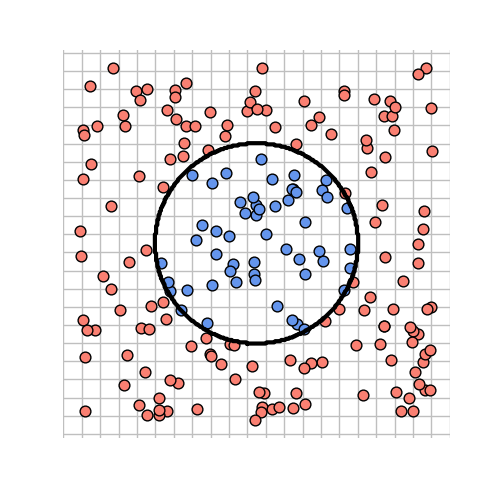
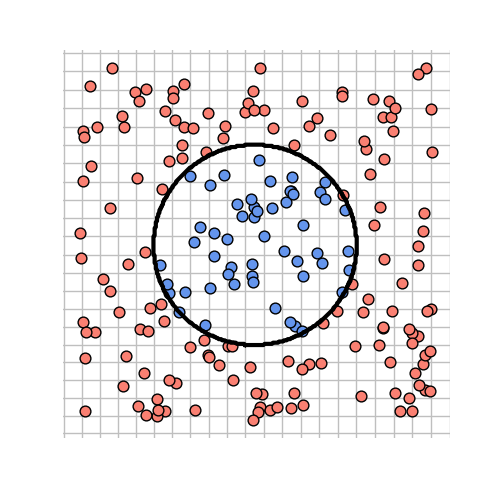
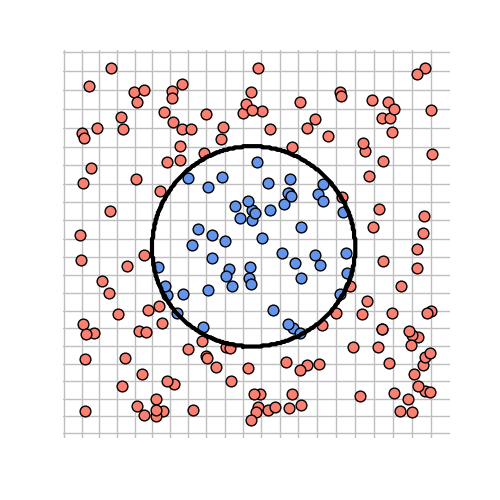
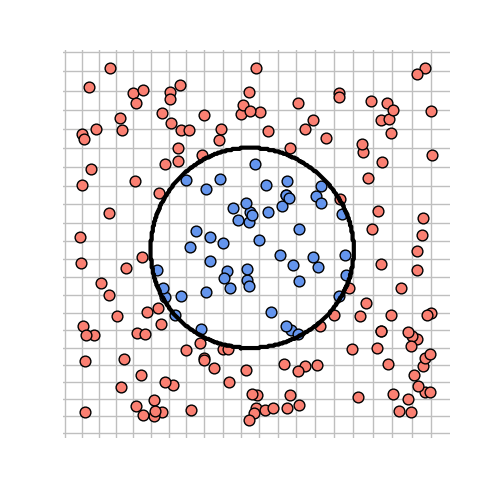
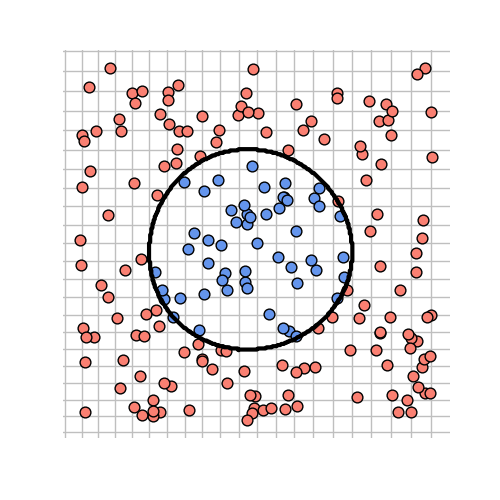
...
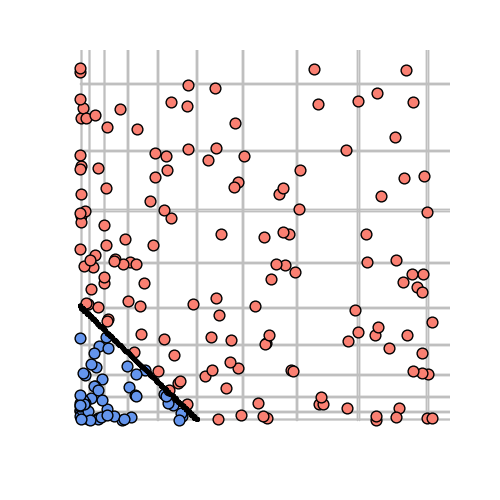
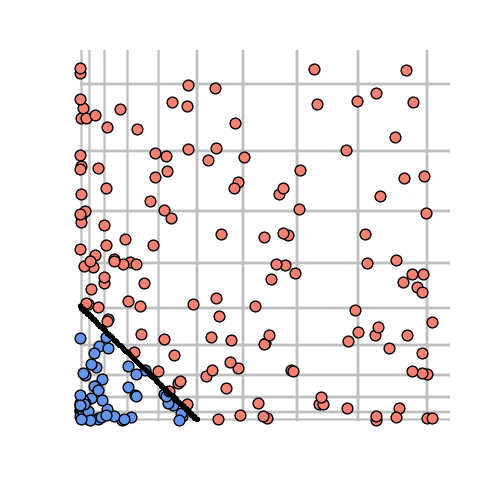
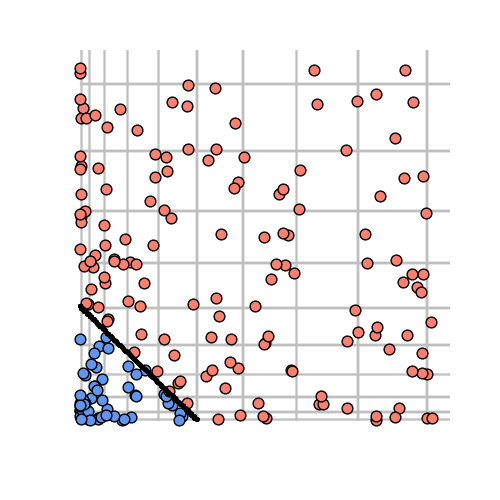
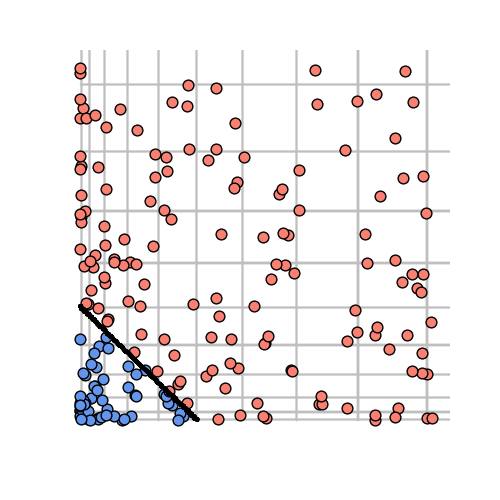
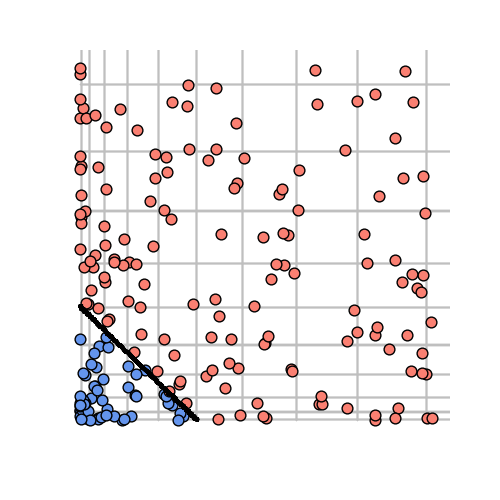

In [38]:
# make instance of warper
%matplotlib inline
x1,x2 = symbols('x1 x2')

# define your own rules here using elementary functions like sin, cos, tanh, sinc, or any polynomial combination of x1 and x2
rule1 = x1*x1 - 4
rule2 = x2*x2 - 4

# these two lines feed the transformation rules into the warping function and produce a toy dataset based on them
demo.define_rule(rule1,rule2)
demo.make_pts()

# this line creates an instance of the slider -  if you do not have bokeh installed you can use the demo1.transformation_slider - this uses matplotlib as the backend (and is considerably slower)
demo.transformation_slider()